<a href="https://colab.research.google.com/github/caroheymes/09-04-DB-SCAN/blob/main/01_911_emergencies_caro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 911 Emergencies 

A US-county would like to know what are the main cases they need to focus on to protect their citizens. They hired you to get that kind of recommandations. In addition they give you a map with all the 911 calls they received over the past years. 

1. Import common libraries (including plotly) 

In [1]:
import os
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
os.chdir('/content/drive/MyDrive/09_04_dbscan')

2. Import the dataset here 👉👉 <a href="https://full-stack-bigdata-datasets.s3.eu-west-3.amazonaws.com/Machine+Learning+non+Supervis%C3%A9/DBSCAN/Datasets/911.csv" target="_blank">911.csv</a>

In [3]:
import pandas as pd
import numpy as np


df = pd.read_csv('/content/drive/MyDrive/09_04_dbscan/911.csv')
df.sample(5)

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
598316,40.024884,-75.276068,MILL CREEK RD & CROSBY BROWN RD; LOWER MERION;...,19035.0,Traffic: DISABLED VEHICLE -,2020-01-18 16:16:43,LOWER MERION,MILL CREEK RD & CROSBY BROWN RD,1
171983,40.138223,-75.131696,NEWPORT AVE & LAMOTT AVE; ABINGTON; Station 3...,19090.0,EMS: SYNCOPAL EPISODE,2017-02-28 14:33:55,ABINGTON,NEWPORT AVE & LAMOTT AVE,1
442756,40.105043,-75.186634,CHURCH RD & LANTERN LN; SPRINGFIELD; Station ...,19075.0,EMS: SEIZURES,2019-01-02 20:18:32,SPRINGFIELD,CHURCH RD & LANTERN LN,1
159094,40.311300,-75.353923,HARLEYSVILLE PIKE & GODSHALL RD; FRANCONIA; 20...,18964.0,Fire: VEHICLE ACCIDENT,2017-01-24 08:32:20,FRANCONIA,HARLEYSVILLE PIKE & GODSHALL RD,1
363592,39.988310,-75.253975,LANCASTER AVE & CITY AVE; LOWER MERION; 2018-0...,19151.0,Traffic: VEHICLE ACCIDENT -,2018-06-26 11:08:29,LOWER MERION,LANCASTER AVE & CITY AVE,1


In [4]:
df.shape

(663522, 9)

3. The dataset is quite big, take a sample of 10 000 observations

In [5]:
df = df.sample(10000, random_state=42)
df.head(5)

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
528196,40.169545,-75.249764,WISSAHICKON AVE & MAPLE AVE; LOWER GWYNEDD; S...,19422.0,EMS: CARDIAC EMERGENCY,2019-07-31 05:13:54,LOWER GWYNEDD,WISSAHICKON AVE & MAPLE AVE,1
537685,40.069832,-75.316295,RAMP I76 EB TO I476 & SCHUYLKILL EXPY EB; WES...,NaN,Traffic: VEHICLE ACCIDENT -,2019-08-23 13:32:45,WEST CONSHOHOCKEN,RAMP I76 EB TO I476 & SCHUYLKILL EXPY EB,1
304176,40.154698,-75.139243,WELSH RD & COMPUTER AVE; UPPER MORELAND; 2018-...,19090.0,Fire: FIRE ALARM,2018-02-02 04:08:55,UPPER MORELAND,WELSH RD & COMPUTER AVE,1
474703,40.382529,-75.473491,BURGUNDY CIR & VINE DR; UPPER HANOVER; Statio...,18073.0,EMS: FALL VICTIM,2019-03-22 04:33:46,UPPER HANOVER,BURGUNDY CIR & VINE DR,1
583079,40.091609,-75.138451,E GLENSIDE AVE & CLIFF TER; CHELTENHAM; 2019-1...,19095.0,Traffic: DISABLED VEHICLE -,2019-12-11 17:15:46,CHELTENHAM,E GLENSIDE AVE & CLIFF TER,1


5. Using plotly scatter mapbox, visualize your data points on a map. You should also differentiate colors depending on `title`

In [6]:
import plotly.express as px
from IPython.display import HTML


In [7]:
fig = px.scatter_mapbox(
           df, 
        lat="lat", 
        lon="lng",
        color="title",
        mapbox_style="carto-positron"
        
)

HTML(fig.to_html())


In [8]:
import folium
from folium import plugins
from IPython.display import HTML
# import matplotlib.pyplot as plt
from folium.plugins import FastMarkerCluster, MarkerCluster

# Centering the map (m) on the mean latitudes and longitudes
m = folium.Map(location=[df['lat'].mean(), df['lng'].mean()], zoom_start=6, tiles='CartoDB Positron')

mc = MarkerCluster(name="Marker Cluster")


for index, row in df.dropna().iterrows():

  popup_text = "{}<br>title :{}<br>desc: {},<br> ".format(
                    index,
                    row.title,
                    row.desc,
                      )
  folium.CircleMarker(location=[row['lat'],row['lng']],
                        radius= 20,
                        color="red",
                        popup=popup_text,
                        fill=True
                  ).add_to(mc)


mc.add_to(m)

folium.LayerControl().add_to(m)
mini_map = plugins.MiniMap(toggle_display=True)
m.add_child(mini_map)

m.save("plot.html")
m

6. The dataset is quite big, let's try to use DBSCAN to help us out. First, create a variable `X` that only includes `lat`, `lng` and `title` columns.

In [9]:
X = df.iloc[:,[0,1,4]]
X

,lat,lng,title
528196,40.169545,-75.249764,EMS: CARDIAC EMERGENCY
537685,40.069832,-75.316295,Traffic: VEHICLE ACCIDENT -
304176,40.154698,-75.139243,Fire: FIRE ALARM
474703,40.382529,-75.473491,EMS: FALL VICTIM
583079,40.091609,-75.138451,Traffic: DISABLED VEHICLE -
...,...,...,...
33288,40.069616,-75.340427,Traffic: DISABLED VEHICLE -
255606,40.248888,-75.681899,Traffic: ROAD OBSTRUCTION -
379602,40.108974,-75.213830,Traffic: VEHICLE ACCIDENT -
512886,40.235613,-75.225128,EMS: VEHICLE ACCIDENT


7. Create dummy variables column `title`.

In [10]:
 dummies = pd.get_dummies(X["title"])
 dummies

,EMS: ABDOMINAL PAINS,EMS: ALLERGIC REACTION,EMS: ALTERED MENTAL STATUS,EMS: AMPUTATION,EMS: ANIMAL BITE,EMS: ASSAULT VICTIM,EMS: BACK PAINS/INJURY,EMS: BUILDING FIRE,EMS: BURN VICTIM,EMS: CARBON MONOXIDE DETECTOR,EMS: CARDIAC ARREST,EMS: CARDIAC EMERGENCY,EMS: CHOKING,EMS: CVA/STROKE,EMS: DEHYDRATION,EMS: DIABETIC EMERGENCY,EMS: DIZZINESS,EMS: ELECTROCUTION,EMS: EMS SPECIAL SERVICE,EMS: EYE INJURY,EMS: FALL VICTIM,EMS: FEVER,EMS: FIRE ALARM,EMS: FIRE INVESTIGATION,EMS: FIRE SPECIAL SERVICE,EMS: FRACTURE,EMS: GAS-ODOR/LEAK,EMS: GENERAL WEAKNESS,EMS: HAZARDOUS MATERIALS INCIDENT,EMS: HEAD INJURY,EMS: HEAT EXHAUSTION,EMS: HEMORRHAGING,EMS: INDUSTRIAL ACCIDENT,EMS: LACERATIONS,EMS: MATERNITY,EMS: MEDICAL ALERT ALARM,EMS: NAUSEA/VOMITING,EMS: OVERDOSE,EMS: POISONING,EMS: RESCUE - GENERAL,...,EMS: UNCONSCIOUS SUBJECT,EMS: UNKNOWN MEDICAL EMERGENCY,EMS: UNRESPONSIVE SUBJECT,EMS: VEHICLE ACCIDENT,EMS: VEHICLE FIRE,Fire: APPLIANCE FIRE,Fire: BUILDING FIRE,Fire: BURN VICTIM,Fire: CARBON MONOXIDE DETECTOR,Fire: CARDIAC ARREST,Fire: DEBRIS/FLUIDS ON HIGHWAY,Fire: ELECTRICAL FIRE OUTSIDE,Fire: ELEVATOR EMERGENCY,Fire: FIRE ALARM,Fire: FIRE INVESTIGATION,Fire: FIRE POLICE NEEDED,Fire: FIRE SPECIAL SERVICE,Fire: GAS-ODOR/LEAK,Fire: HAZARDOUS MATERIALS INCIDENT,Fire: POISONING,Fire: PUMP DETAIL,Fire: RESCUE - ELEVATOR,Fire: RESCUE - GENERAL,Fire: RESCUE - TECHNICAL,Fire: RESCUE - WATER,Fire: S/B AT HELICOPTER LANDING,Fire: TRANSFERRED CALL,Fire: TRASH/DUMPSTER FIRE,Fire: UNKNOWN TYPE FIRE,Fire: VEHICLE ACCIDENT,Fire: VEHICLE FIRE,Fire: VEHICLE LEAKING FUEL,Fire: WOODS/FIELD FIRE,Traffic: DEBRIS/FLUIDS ON HIGHWAY -,Traffic: DISABLED VEHICLE -,Traffic: HAZARDOUS ROAD CONDITIONS -,Traffic: ROAD OBSTRUCTION -,Traffic: VEHICLE ACCIDENT -,Traffic: VEHICLE FIRE -,Traffic: VEHICLE LEAKING FUEL -
528196,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
537685,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
304176,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
474703,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
583079,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33288,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
255606,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
379602,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
512886,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [11]:
X = pd.concat([X, dummies], axis = 1).drop('title', axis=1)

In [12]:
X

,lat,lng,EMS: ABDOMINAL PAINS,EMS: ALLERGIC REACTION,EMS: ALTERED MENTAL STATUS,EMS: AMPUTATION,EMS: ANIMAL BITE,EMS: ASSAULT VICTIM,EMS: BACK PAINS/INJURY,EMS: BUILDING FIRE,EMS: BURN VICTIM,EMS: CARBON MONOXIDE DETECTOR,EMS: CARDIAC ARREST,EMS: CARDIAC EMERGENCY,EMS: CHOKING,EMS: CVA/STROKE,EMS: DEHYDRATION,EMS: DIABETIC EMERGENCY,EMS: DIZZINESS,EMS: ELECTROCUTION,EMS: EMS SPECIAL SERVICE,EMS: EYE INJURY,EMS: FALL VICTIM,EMS: FEVER,EMS: FIRE ALARM,EMS: FIRE INVESTIGATION,EMS: FIRE SPECIAL SERVICE,EMS: FRACTURE,EMS: GAS-ODOR/LEAK,EMS: GENERAL WEAKNESS,EMS: HAZARDOUS MATERIALS INCIDENT,EMS: HEAD INJURY,EMS: HEAT EXHAUSTION,EMS: HEMORRHAGING,EMS: INDUSTRIAL ACCIDENT,EMS: LACERATIONS,EMS: MATERNITY,EMS: MEDICAL ALERT ALARM,EMS: NAUSEA/VOMITING,EMS: OVERDOSE,...,EMS: UNCONSCIOUS SUBJECT,EMS: UNKNOWN MEDICAL EMERGENCY,EMS: UNRESPONSIVE SUBJECT,EMS: VEHICLE ACCIDENT,EMS: VEHICLE FIRE,Fire: APPLIANCE FIRE,Fire: BUILDING FIRE,Fire: BURN VICTIM,Fire: CARBON MONOXIDE DETECTOR,Fire: CARDIAC ARREST,Fire: DEBRIS/FLUIDS ON HIGHWAY,Fire: ELECTRICAL FIRE OUTSIDE,Fire: ELEVATOR EMERGENCY,Fire: FIRE ALARM,Fire: FIRE INVESTIGATION,Fire: FIRE POLICE NEEDED,Fire: FIRE SPECIAL SERVICE,Fire: GAS-ODOR/LEAK,Fire: HAZARDOUS MATERIALS INCIDENT,Fire: POISONING,Fire: PUMP DETAIL,Fire: RESCUE - ELEVATOR,Fire: RESCUE - GENERAL,Fire: RESCUE - TECHNICAL,Fire: RESCUE - WATER,Fire: S/B AT HELICOPTER LANDING,Fire: TRANSFERRED CALL,Fire: TRASH/DUMPSTER FIRE,Fire: UNKNOWN TYPE FIRE,Fire: VEHICLE ACCIDENT,Fire: VEHICLE FIRE,Fire: VEHICLE LEAKING FUEL,Fire: WOODS/FIELD FIRE,Traffic: DEBRIS/FLUIDS ON HIGHWAY -,Traffic: DISABLED VEHICLE -,Traffic: HAZARDOUS ROAD CONDITIONS -,Traffic: ROAD OBSTRUCTION -,Traffic: VEHICLE ACCIDENT -,Traffic: VEHICLE FIRE -,Traffic: VEHICLE LEAKING FUEL -
528196,40.169545,-75.249764,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
537685,40.069832,-75.316295,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
304176,40.154698,-75.139243,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
474703,40.382529,-75.473491,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
583079,40.091609,-75.138451,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33288,40.069616,-75.340427,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
255606,40.248888,-75.681899,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
379602,40.108974,-75.213830,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
512886,40.235613,-75.225128,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


8. Let's start using DBSCAN, import the module and fit DBSCAN to your data. You should use `eps=0.1`, `min_samples=100` and `metric="manhattan"` as parameters

In [13]:

# import DBSCAN from sklearn and numpy
from sklearn.cluster import DBSCAN
import numpy as np
# Instanciate DBSCAN 
db = DBSCAN(eps=0.1, min_samples=100, metric="manhattan", algorithm="brute")

# Fit on data 
## No need to normalize data, it already is! 
db.fit(X)


DBSCAN(algorithm='brute', eps=0.1, leaf_size=30, metric='manhattan',
       metric_params=None, min_samples=100, n_jobs=None, p=None)

9. Find out how many clusters DBSCAN created. 

Text(0.5, 1.0, 'Clusters determined by DBSCAN')

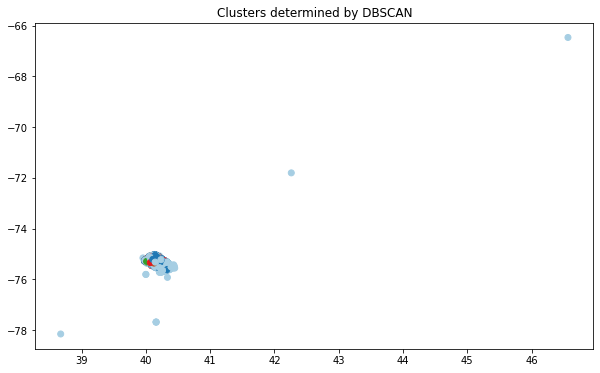

In [15]:
import matplotlib.pyplot as plt

y_pred = db.fit_predict(X)
plt.figure(figsize=(10,6))
plt.scatter(X['lat'], X['lng'],c=y_pred, cmap='Paired')
plt.title("Clusters determined by DBSCAN")

In [16]:
np.unique(db.labels_)

array([-1,  0,  1,  2,  3,  4,  5,  6])

10. Add a new column `"cluster"` to `X` where each observations are going to be the label of the corresponding cluster.

In [17]:
X['cluster'] = db.labels_
X

,lat,lng,EMS: ABDOMINAL PAINS,EMS: ALLERGIC REACTION,EMS: ALTERED MENTAL STATUS,EMS: AMPUTATION,EMS: ANIMAL BITE,EMS: ASSAULT VICTIM,EMS: BACK PAINS/INJURY,EMS: BUILDING FIRE,EMS: BURN VICTIM,EMS: CARBON MONOXIDE DETECTOR,EMS: CARDIAC ARREST,EMS: CARDIAC EMERGENCY,EMS: CHOKING,EMS: CVA/STROKE,EMS: DEHYDRATION,EMS: DIABETIC EMERGENCY,EMS: DIZZINESS,EMS: ELECTROCUTION,EMS: EMS SPECIAL SERVICE,EMS: EYE INJURY,EMS: FALL VICTIM,EMS: FEVER,EMS: FIRE ALARM,EMS: FIRE INVESTIGATION,EMS: FIRE SPECIAL SERVICE,EMS: FRACTURE,EMS: GAS-ODOR/LEAK,EMS: GENERAL WEAKNESS,EMS: HAZARDOUS MATERIALS INCIDENT,EMS: HEAD INJURY,EMS: HEAT EXHAUSTION,EMS: HEMORRHAGING,EMS: INDUSTRIAL ACCIDENT,EMS: LACERATIONS,EMS: MATERNITY,EMS: MEDICAL ALERT ALARM,EMS: NAUSEA/VOMITING,EMS: OVERDOSE,...,EMS: UNKNOWN MEDICAL EMERGENCY,EMS: UNRESPONSIVE SUBJECT,EMS: VEHICLE ACCIDENT,EMS: VEHICLE FIRE,Fire: APPLIANCE FIRE,Fire: BUILDING FIRE,Fire: BURN VICTIM,Fire: CARBON MONOXIDE DETECTOR,Fire: CARDIAC ARREST,Fire: DEBRIS/FLUIDS ON HIGHWAY,Fire: ELECTRICAL FIRE OUTSIDE,Fire: ELEVATOR EMERGENCY,Fire: FIRE ALARM,Fire: FIRE INVESTIGATION,Fire: FIRE POLICE NEEDED,Fire: FIRE SPECIAL SERVICE,Fire: GAS-ODOR/LEAK,Fire: HAZARDOUS MATERIALS INCIDENT,Fire: POISONING,Fire: PUMP DETAIL,Fire: RESCUE - ELEVATOR,Fire: RESCUE - GENERAL,Fire: RESCUE - TECHNICAL,Fire: RESCUE - WATER,Fire: S/B AT HELICOPTER LANDING,Fire: TRANSFERRED CALL,Fire: TRASH/DUMPSTER FIRE,Fire: UNKNOWN TYPE FIRE,Fire: VEHICLE ACCIDENT,Fire: VEHICLE FIRE,Fire: VEHICLE LEAKING FUEL,Fire: WOODS/FIELD FIRE,Traffic: DEBRIS/FLUIDS ON HIGHWAY -,Traffic: DISABLED VEHICLE -,Traffic: HAZARDOUS ROAD CONDITIONS -,Traffic: ROAD OBSTRUCTION -,Traffic: VEHICLE ACCIDENT -,Traffic: VEHICLE FIRE -,Traffic: VEHICLE LEAKING FUEL -,cluster
528196,40.169545,-75.249764,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6
537685,40.069832,-75.316295,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
304176,40.154698,-75.139243,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
474703,40.382529,-75.473491,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1
583079,40.091609,-75.138451,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33288,40.069616,-75.340427,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,2
255606,40.248888,-75.681899,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,-1
379602,40.108974,-75.213830,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
512886,40.235613,-75.225128,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-1


11. Visualize all the clusters on a map except all the ones that DBSCAN considered as outliers.

In [18]:
fig = px.scatter_mapbox(
        X[X.cluster != -1], 
        lat="lat", 
        lon="lng",
        color="cluster",
        mapbox_style="carto-positron"
)

HTML(fig.to_html())


12. Let's try to visualize each titles DBSCAN found. Let's first add the column `cluster` to your raw sample of data.

In [19]:
result = pd.merge(df, X[['cluster']], left_on = df.index, right_on= X.index, how='left').drop('key_0', axis=1)

In [20]:
result

,lat,lng,desc,zip,title,timeStamp,twp,addr,e,cluster
0,40.169545,-75.249764,WISSAHICKON AVE & MAPLE AVE; LOWER GWYNEDD; S...,19422.0,EMS: CARDIAC EMERGENCY,2019-07-31 05:13:54,LOWER GWYNEDD,WISSAHICKON AVE & MAPLE AVE,1,6
1,40.069832,-75.316295,RAMP I76 EB TO I476 & SCHUYLKILL EXPY EB; WES...,NaN,Traffic: VEHICLE ACCIDENT -,2019-08-23 13:32:45,WEST CONSHOHOCKEN,RAMP I76 EB TO I476 & SCHUYLKILL EXPY EB,1,0
2,40.154698,-75.139243,WELSH RD & COMPUTER AVE; UPPER MORELAND; 2018-...,19090.0,Fire: FIRE ALARM,2018-02-02 04:08:55,UPPER MORELAND,WELSH RD & COMPUTER AVE,1,1
3,40.382529,-75.473491,BURGUNDY CIR & VINE DR; UPPER HANOVER; Statio...,18073.0,EMS: FALL VICTIM,2019-03-22 04:33:46,UPPER HANOVER,BURGUNDY CIR & VINE DR,1,-1
4,40.091609,-75.138451,E GLENSIDE AVE & CLIFF TER; CHELTENHAM; 2019-1...,19095.0,Traffic: DISABLED VEHICLE -,2019-12-11 17:15:46,CHELTENHAM,E GLENSIDE AVE & CLIFF TER,1,2
...,...,...,...,...,...,...,...,...,...,...
9995,40.069616,-75.340427,HOLSTEIN RD & TRINITY LN; UPPER MERION; 2016-0...,19428.0,Traffic: DISABLED VEHICLE -,2016-03-03 08:06:37,UPPER MERION,HOLSTEIN RD & TRINITY LN,1,2
9996,40.248888,-75.681899,RT422 BYP & RAMP S GROSSTOWN RD TO RT422 WB; W...,19464.0,Traffic: ROAD OBSTRUCTION -,2017-10-05 15:06:49,WEST POTTSGROVE,RT422 BYP & RAMP S GROSSTOWN RD TO RT422 WB,1,-1
9997,40.108974,-75.213830,BETHLEHEM PIKE & SPRINGFIELD AVE; SPRINGFIELD;...,19031.0,Traffic: VEHICLE ACCIDENT -,2018-08-04 12:40:44,SPRINGFIELD,BETHLEHEM PIKE & SPRINGFIELD AVE,1,0
9998,40.235613,-75.225128,HORSHAM RD; MONTGOMERY; Station 345A; 2019-06...,NaN,EMS: VEHICLE ACCIDENT,2019-06-25 08:52:57,MONTGOMERY,HORSHAM RD,1,-1


13. Visualize all data points on a map except outliers using plotly. You should have different colors per `title`. 

14. What would then be your recommandations for this US county politicians? 

In [21]:
fig = px.scatter_mapbox(
        result[result.cluster != -1], 
        lat="lat", 
        lon="lng",
        color="title",
        mapbox_style="carto-positron"
)

HTML(fig.to_html())


**The map shows the main topics to focus on and the main areas where this events occur. Therefore these are the areas that politics should focus on.** 